## Assignment 2 (OPTION 2)

##### CID: 01731821

##### Google Colab notebook link: [Google Colab Notebook]()

### OPTION 2: A DeepDream-like model

Before starting any of the questions, we need to import the required libraries.

In [1]:
# Import necessary libraries
import numpy as np
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from tqdm.notebook import tqdm
from torchvision import models

In [2]:
# Set seed for reproducibility
SEED = 1731821
np.random.seed(SEED)
torch.manual_seed(SEED)
print("Seed set to", SEED)

Seed set to 1731821


In [3]:
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("mps")
print(device)

mps


### Part 1: A convolutional neural network, dropout and batch-norm

#### Task 1: Implement and train a CNN

In [4]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 32

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False)

# Faster training with less memory
trainloader = list(trainloader)
testloader = list(testloader)

classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

Files already downloaded and verified
Files already downloaded and verified


In [5]:
# get some random training images; this will load a set of images of size batchsize 
dataiter = iter(trainloader)
images, labels = next(dataiter)
img = images[0] # take just the first image; the above thing is an array of images of size batchsize
img = img / 2 + 0.5     # unnormalize

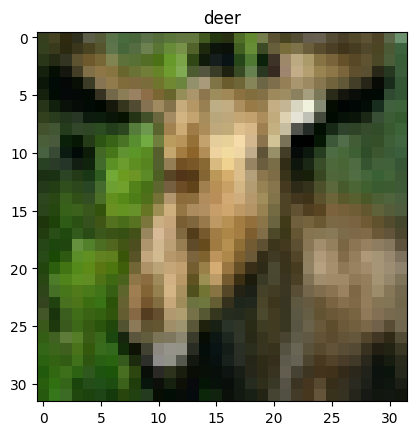

In [6]:
# Print the original image
npimg = img.numpy() # translate to numpy
npimg_t = np.transpose(npimg, (1, 2, 0))
plt.imshow(npimg_t)
plt.title(str(classes[labels[0]]))
plt.show()

In [7]:
def convolution2d(image, kernel):
    m, n = kernel.shape
    if (m == n):
        y, x = image.shape
        y = y - m + 1
        x = x - m + 1
        new_image = np.zeros((y,x))
        for i in range(y):
            for j in range(x):
                # what's going on? # we take the product of a subset of the image and the kernel and sum the terms
                new_image[i][j] = np.sum(image[i:i+m, j:j+m]*kernel) 
    return new_image

(32, 32, 3)


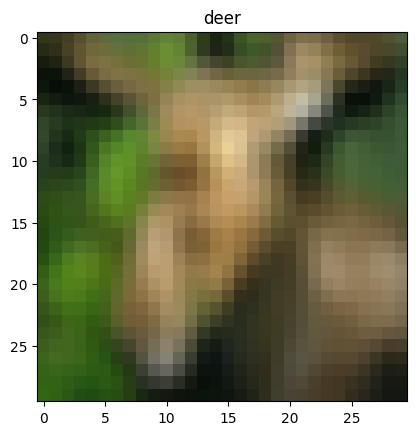

In [8]:
print(npimg_t.shape)
# Let's apply a convolution per each 'channel' of the input with a blurring kernel
K = np.array([[0.1111, 0.1111, 0.1111],
         [0.1111, 0.1111, 0.1111],
         [0.1111, 0.1111, 0.1111]])
npimg_conv1 = np.zeros([30,30,3])
for it in range(npimg_t.shape[2]):
    npimg_conv1[:,:,it] = convolution2d(npimg_t[:,:,it], K)
plt.imshow(npimg_conv1)
plt.title(str(classes[labels[0]]))
plt.show()

In [9]:
class Net(nn.Module):
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net()
net.to(device)

Net(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
)

In [10]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _, predicted = outputs.max(1)
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.7252 | Test Loss: 2.0127 | Train Accuracy: 15.95% | Test Accuracy: 24.01%
Epoch: 002 | Train Loss: 1.3739 | Test Loss: 1.6050 | Train Accuracy: 33.65% | Test Accuracy: 39.75%
Epoch: 003 | Train Loss: 1.1925 | Test Loss: 1.4253 | Train Accuracy: 43.59% | Test Accuracy: 47.59%
Epoch: 004 | Train Loss: 1.0431 | Test Loss: 1.3114 | Train Accuracy: 49.65% | Test Accuracy: 52.07%
Epoch: 005 | Train Loss: 0.9095 | Test Loss: 1.2082 | Train Accuracy: 54.12% | Test Accuracy: 56.42%
Epoch: 006 | Train Loss: 0.8223 | Test Loss: 1.1096 | Train Accuracy: 58.33% | Test Accuracy: 60.35%
Epoch: 007 | Train Loss: 0.8761 | Test Loss: 1.0311 | Train Accuracy: 62.18% | Test Accuracy: 63.54%
Epoch: 008 | Train Loss: 0.9631 | Test Loss: 0.9616 | Train Accuracy: 65.43% | Test Accuracy: 66.04%
Epoch: 009 | Train Loss: 0.9847 | Test Loss: 0.9062 | Train Accuracy: 68.18% | Test Accuracy: 68.24%
Epoch: 010 | Train Loss: 0.9887 | Test Loss: 0.8640 | Train Accuracy: 70.83% | Test Accurac

#### Task 2: Dropout

In [11]:
class Net_Dropout(nn.Module):
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)
        self.dropout1 = nn.Dropout(p=0.2)
        self.dropout2 = nn.Dropout(p=0.2)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = self.dropout1(x)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net_Dropout()
net.to(device)

Net_Dropout(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (dropout1): Dropout(p=0.2, inplace=False)
  (dropout2): Dropout(p=0.2, inplace=False)
)

In [12]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _, predicted = outputs.max(1)
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.7906 | Test Loss: 2.0392 | Train Accuracy: 16.14% | Test Accuracy: 22.42%
Epoch: 002 | Train Loss: 1.4285 | Test Loss: 1.6762 | Train Accuracy: 31.45% | Test Accuracy: 36.46%
Epoch: 003 | Train Loss: 1.2078 | Test Loss: 1.4955 | Train Accuracy: 40.78% | Test Accuracy: 44.94%
Epoch: 004 | Train Loss: 1.1465 | Test Loss: 1.3648 | Train Accuracy: 47.31% | Test Accuracy: 50.00%
Epoch: 005 | Train Loss: 1.0104 | Test Loss: 1.2579 | Train Accuracy: 52.23% | Test Accuracy: 54.43%
Epoch: 006 | Train Loss: 1.0690 | Test Loss: 1.1829 | Train Accuracy: 56.13% | Test Accuracy: 57.41%
Epoch: 007 | Train Loss: 0.9059 | Test Loss: 1.1016 | Train Accuracy: 59.26% | Test Accuracy: 60.57%
Epoch: 008 | Train Loss: 0.9714 | Test Loss: 1.0331 | Train Accuracy: 62.25% | Test Accuracy: 63.47%
Epoch: 009 | Train Loss: 0.7947 | Test Loss: 0.9776 | Train Accuracy: 64.85% | Test Accuracy: 65.70%
Epoch: 010 | Train Loss: 0.8223 | Test Loss: 0.9307 | Train Accuracy: 67.52% | Test Accurac

#### Task 3: BatchNorm

In [29]:
class Net_Dropout_BN(nn.Module):
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)
        self.dropout1 = nn.Dropout(p=0.5)
        self.dropout2 = nn.Dropout(p=0.5)
        self.batchnorm1 = nn.BatchNorm2d(64)
        self.batchnorm2 = nn.BatchNorm2d(128)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.batchnorm1(self.conv1(x))))
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = self.dropout1(x)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net_Dropout_BN()
net.to(device)

Net_Dropout_BN(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (dropout1): Dropout(p=0.2, inplace=False)
  (dropout2): Dropout(p=0.2, inplace=False)
  (batchnorm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (batchnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

In [30]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _ , predicted = outputs.max(1) 
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.1788 | Test Loss: 1.3625 | Train Accuracy: 37.06% | Test Accuracy: 49.95%
Epoch: 002 | Train Loss: 1.0298 | Test Loss: 1.1173 | Train Accuracy: 55.58% | Test Accuracy: 59.74%
Epoch: 003 | Train Loss: 0.8001 | Test Loss: 0.9861 | Train Accuracy: 62.96% | Test Accuracy: 64.94%
Epoch: 004 | Train Loss: 0.9299 | Test Loss: 0.9059 | Train Accuracy: 67.59% | Test Accuracy: 68.55%
Epoch: 005 | Train Loss: 0.9616 | Test Loss: 0.8588 | Train Accuracy: 71.16% | Test Accuracy: 70.77%
Epoch: 006 | Train Loss: 1.2489 | Test Loss: 0.8060 | Train Accuracy: 73.71% | Test Accuracy: 71.86%
Epoch: 007 | Train Loss: 0.9243 | Test Loss: 0.8047 | Train Accuracy: 76.10% | Test Accuracy: 72.91%
Epoch: 008 | Train Loss: 1.0623 | Test Loss: 0.8118 | Train Accuracy: 78.06% | Test Accuracy: 73.31%
Epoch: 009 | Train Loss: 1.2149 | Test Loss: 0.8091 | Train Accuracy: 79.86% | Test Accuracy: 73.16%
Epoch: 010 | Train Loss: 0.9498 | Test Loss: 0.8048 | Train Accuracy: 81.63% | Test Accurac

### Part 2: The DeepDream method

#### Task 1: Load an image

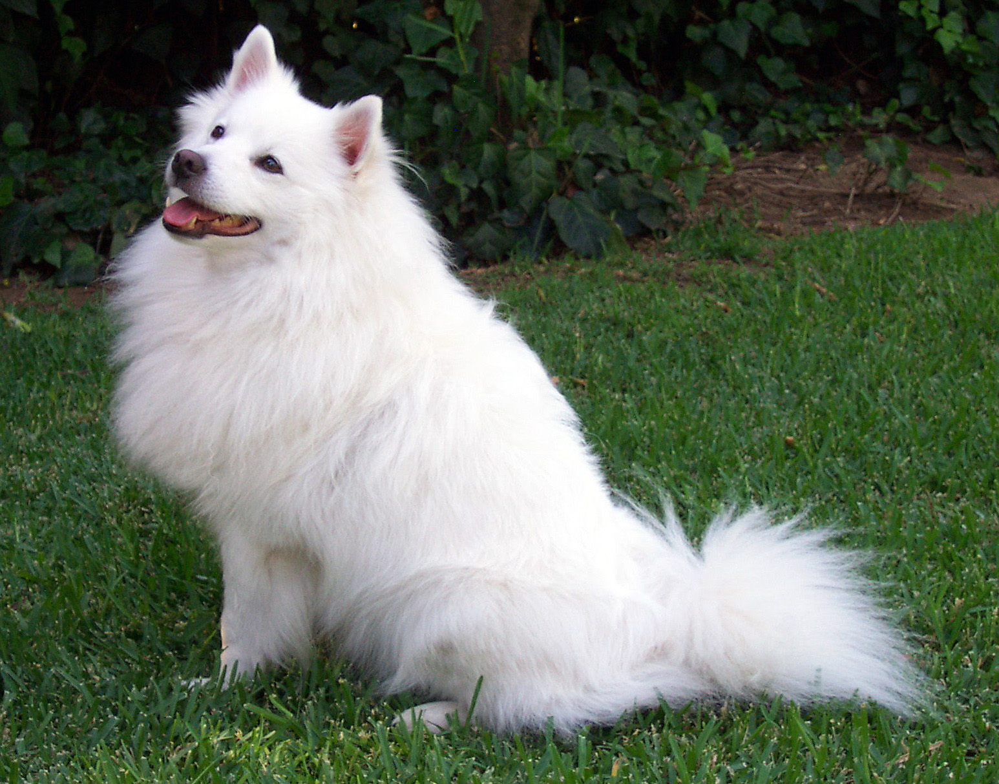

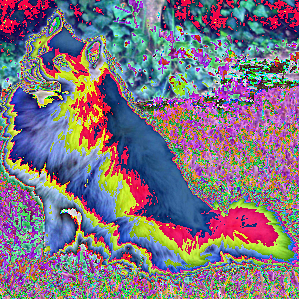

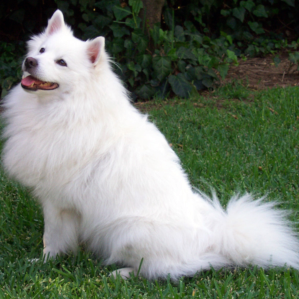

In [15]:
import urllib
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")

try: urllib.URLopener().retrieve(url, filename)
except: urllib.request.urlretrieve(url, filename)

# sample execution (requires torchvision)
from PIL import Image
from torchvision import transforms
import IPython.display as display
input_image = Image.open(filename)
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

input_tensor = preprocess(input_image)
input_tensor = input_tensor.to(device)
input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model


# Print inital image
display.display(Image.fromarray(np.array(input_image)))

# Print transformed image
output_img = transforms.ToPILImage()(input_batch.squeeze(0))  
display.display(output_img)

# Print unnormalized image
output_img = transforms.ToPILImage()(input_batch.squeeze(0).mul(torch.tensor([0.229, 0.224, 0.225], device=device).view(3,1,1)).add(torch.tensor([0.485, 0.456, 0.406], device=device).view(3,1,1)))
display.display(output_img)

#### Task 2: Load the pre-trained model and write code to allow for a 'hook'

In [16]:
model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
model.to(device)
model.eval()

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [17]:
outputs = []
def hook(module, input, output):
    outputs.append(output)

#### Task 3: Creat a hook

In [18]:
# Choose layer to hook using https://github.com/pytorch/vision/blob/main/torchvision/models/inception.py
h = model.Mixed_6a.register_forward_hook(hook)

#### Task 4: Implement the deepdream optimisation loop

In [19]:
from tqdm.notebook import tqdm
# Define the DeepDream function
def deepdream(img, iterations, lr, tqdm_active=True):
    min, max = img.min(), img.max()
    # Define the optimizer
    optimizer = torch.optim.Adam([img.requires_grad_()], lr=lr)

    # Perform gradient ascent for the given number of iterations
    if tqdm_active:
        for i in tqdm(range(iterations)):
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1])

            # Compute the gradients and scale by their absolute average
            loss.backward()
            avg_grad = torch.abs(img.grad).mean()
            img.grad /= -avg_grad

            # Gradient ascent step
            optimizer.step()

            # Clip the image to the valid range
            img.data.clamp_(-1,1)
    else:
        for i in range(iterations):
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1])

            # Compute the gradients and scale by their absolute average
            loss.backward()
            avg_grad = torch.abs(img.grad).mean()
            img.grad /= -avg_grad

            # Gradient ascent step
            optimizer.step()

            # Clip the image to the valid range
            img.data.clamp_(-1,1)
        
    # Remove the hook
    h.remove()

    return img

# Run DeepDream on the input image
dream_img = deepdream(input_batch, iterations=50, lr=0.01)

  0%|          | 0/50 [00:00<?, ?it/s]

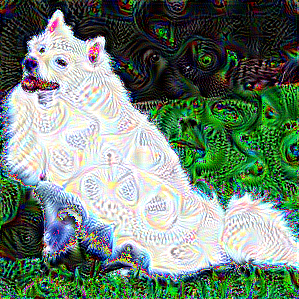

In [20]:
# Display the output from our optimisation loop 
output_img = transforms.ToPILImage()(input_batch.squeeze(0))
display.display(output_img)

#### Task 5: Present comparisons of outputs

In [21]:
layers = ['Mixed_7c', 'Mixed_6e', 'Mixed_6d', 'Mixed_6c', 'Mixed_6b', 'Mixed_6a', 'Mixed_5b']
opti_steps = [10, 100, 500]
store_images = []
for layer in tqdm(layers):
    for step in opti_steps:
        #print("Layer: ", layer, "Opti steps: ", step)
        input_image = Image.open(filename)
        input_tensor = preprocess(input_image)
        input_tensor = input_tensor.to(device)
        input_batch = input_tensor.unsqueeze(0)
        model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
        model.to(device)
        model.eval()
        outputs = []
        h = model._modules.get(layer).register_forward_hook(hook)
        dream_img = deepdream(input_batch, iterations=step, lr=0.01, tqdm_active=False)
        output_img = transforms.ToPILImage()(dream_img.squeeze(0))
        store_images.append(output_img)

  0%|          | 0/7 [00:00<?, ?it/s]

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


KeyboardInterrupt: 

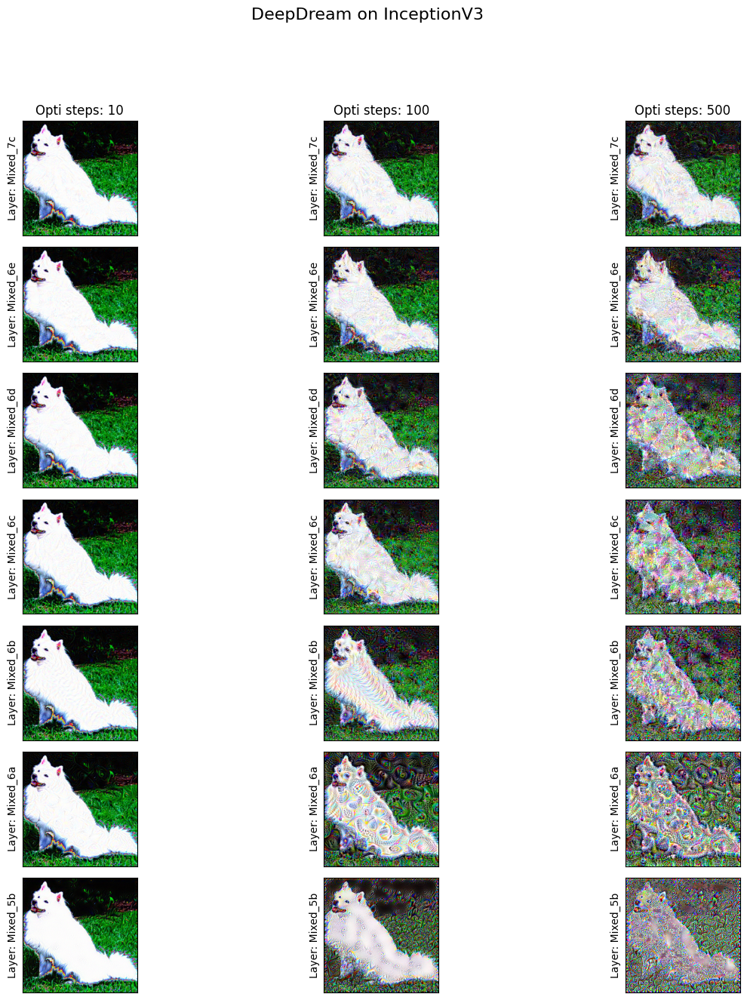

In [ ]:
# Display all images as a grid
fig, axs = plt.subplots(7, 3, figsize=(15, 15))
# reduce whitespace between images
fig.subplots_adjust(hspace=0.1, wspace=0.1)
# add legend to the plot
for i in range(7):
    for j in range(3):
        axs[i, j].imshow(store_images[i*3+j])
        axs[i, j].set_ylabel("Layer: "+str(layers[i]))
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        if i==0:
            axs[i, j].set_title("Opti steps: "+str(opti_steps[j]))
        
# set title
fig.suptitle('DeepDream on InceptionV3', fontsize=16)
plt.show()

In [ ]:
layer = 'Mixed_6a'
opti_steps = np.linspace(10, 1000, 20, dtype=int)
store_images = []
for step in tqdm(opti_steps):
    #print("Layer: ", layer, "Opti steps: ", step)
    input_image = Image.open(filename)
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0)
    model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
    model.to(device)
    model.eval()
    outputs = []
    h = model._modules.get(layer).register_forward_hook(hook)
    dream_img = deepdream(input_batch, iterations=step, lr=0.01, tqdm_active=False)
    output_img = transforms.ToPILImage()(dream_img.squeeze(0))
    store_images.append(output_img)

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cac

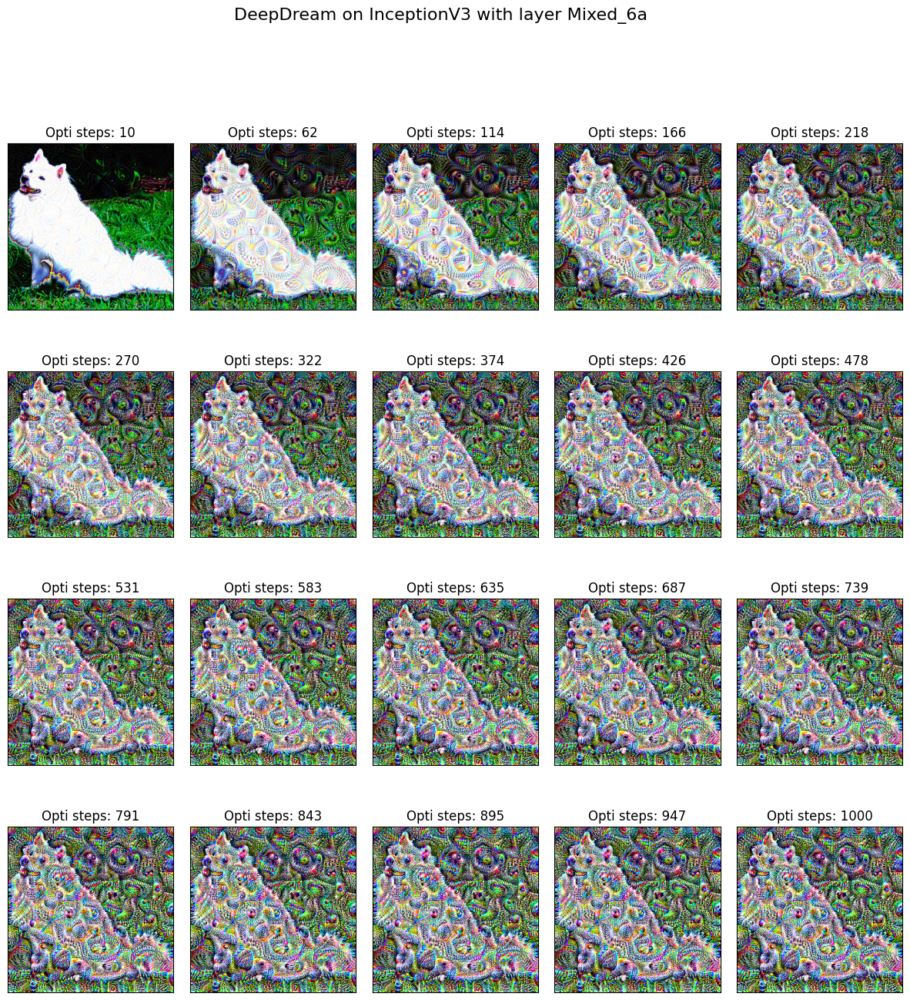

In [ ]:
# Display the images as a grid
fig, axs = plt.subplots(4, 5, figsize=(15, 15))
# reduce whitespace between images
fig.subplots_adjust(hspace=0.1, wspace=0.1) 
for i in range(4):
    for j in range(5):
        axs[i, j].imshow(store_images[i*5+j])
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        axs[i, j].set_title("Opti steps: "+str(opti_steps[i*5+j]))

# set title
fig.suptitle(f"DeepDream on InceptionV3 with layer {layer}", fontsize=16)
plt.show()


#### Task 6: Improve the results by allowing to optimise for multiple layer activations

In [ ]:
# Define the DeepDream function for multiple layers
def deepdream_layers(img, iterations, lr):
    # Define the optimizer
    optimizer = torch.optim.Adam([img.requires_grad_()], lr=lr)

    # Perform gradient ascent for the given number of iterations
    for i in tqdm(range(iterations)):
        optimizer.zero_grad()

        # Forward pass through the model to get the loss (L2 norm of the output)
        model(img)

        # Compute the loss (L2 norm) of multiple layers’ outputs
        loss = 0
        # select only the layers we want to use
        for output in outputs[-len(layers):]:
            loss += torch.norm(output)

        # Compute the gradients and scale by their absolute average
        loss.backward()
        avg_grad = torch.abs(img.grad).mean()
        img.grad /= -avg_grad

        # Gradient ascent step
        optimizer.step()

        # Clip the image to the valid range
        img.data.clamp_(-1,1)

    return img

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

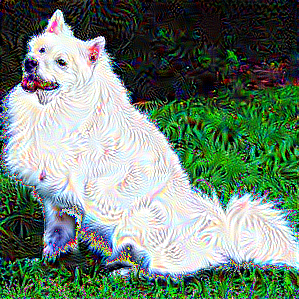

In [ ]:
layers = ['Mixed_6c', 'Mixed_6b', 'Mixed_6a', 'Mixed_5b']

input_image = Image.open(filename)
input_tensor = preprocess(input_image)
input_tensor = input_tensor.to(device)
input_batch = input_tensor.unsqueeze(0)
model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
model.to(device)
model.eval()
outputs = []
for layer in layers:
    h = model._modules.get(layer).register_forward_hook(hook)
dream_img = deepdream_layers(input_batch, iterations=50, lr=0.01)
output_img = transforms.ToPILImage()(dream_img.squeeze(0))
display.display(output_img)

#### Task 7: Play around with the model and create your own dream

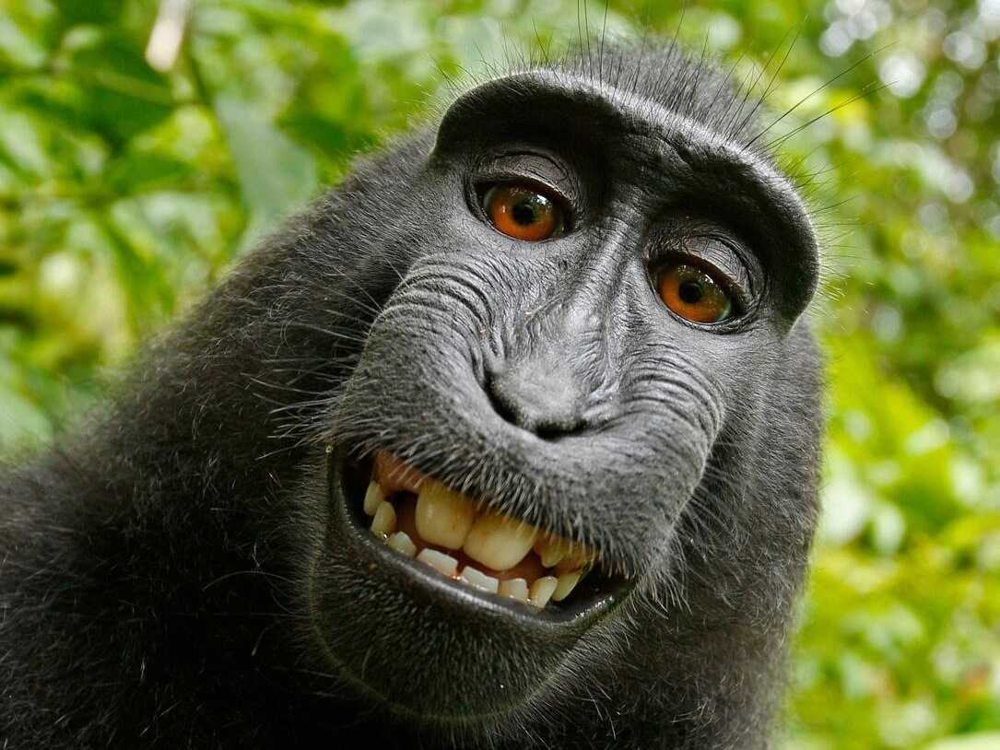

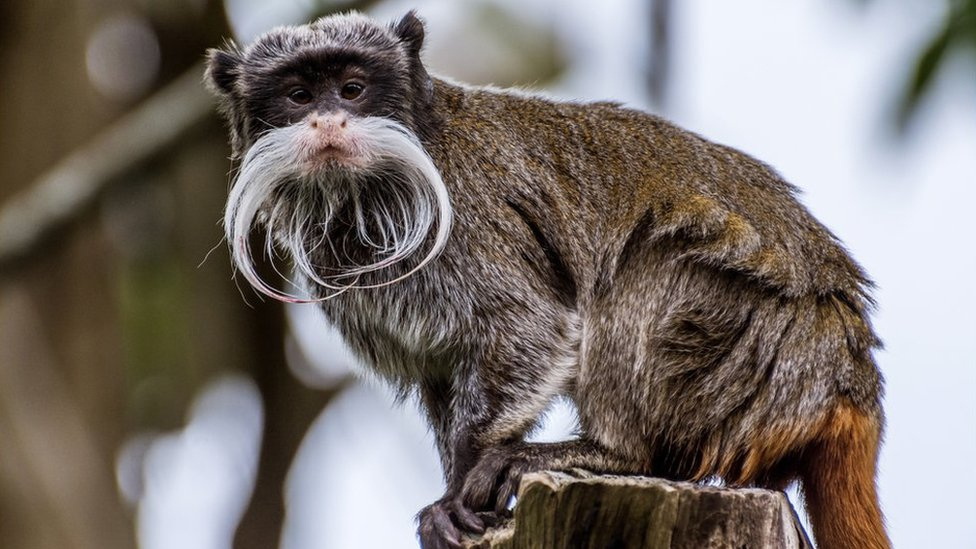

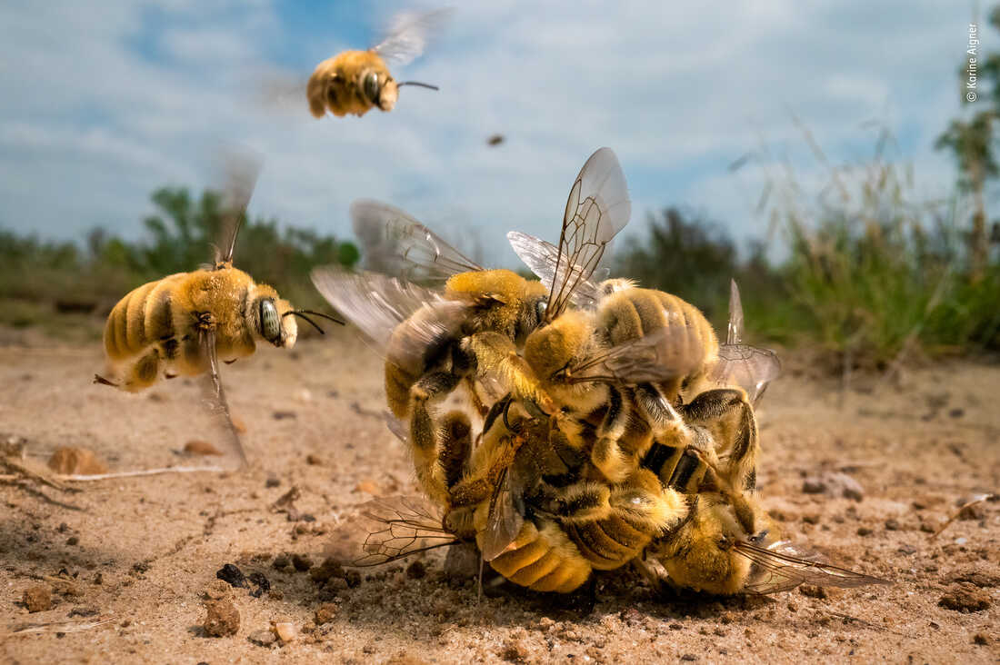

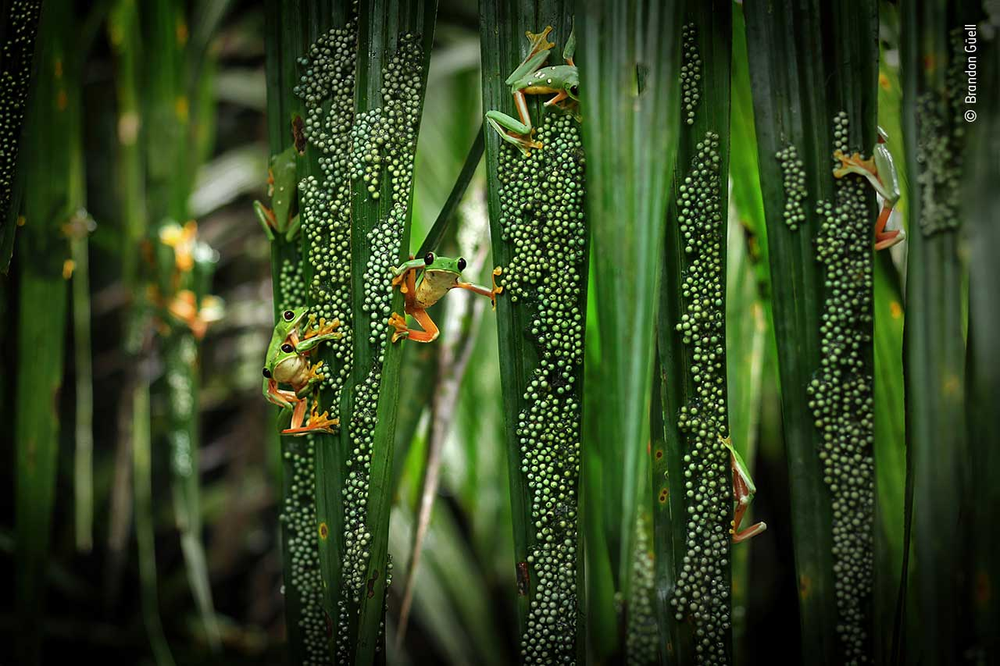

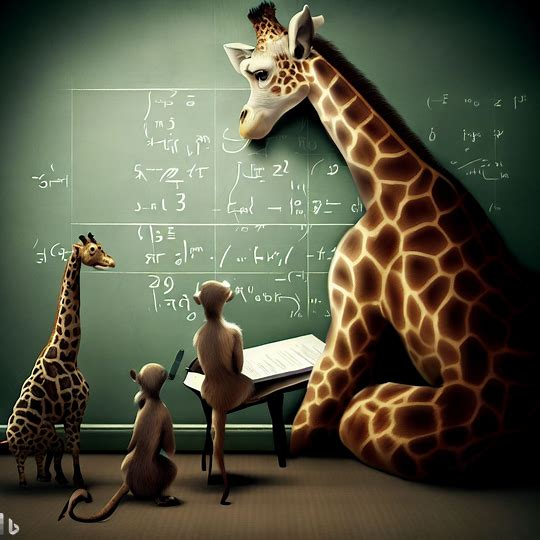

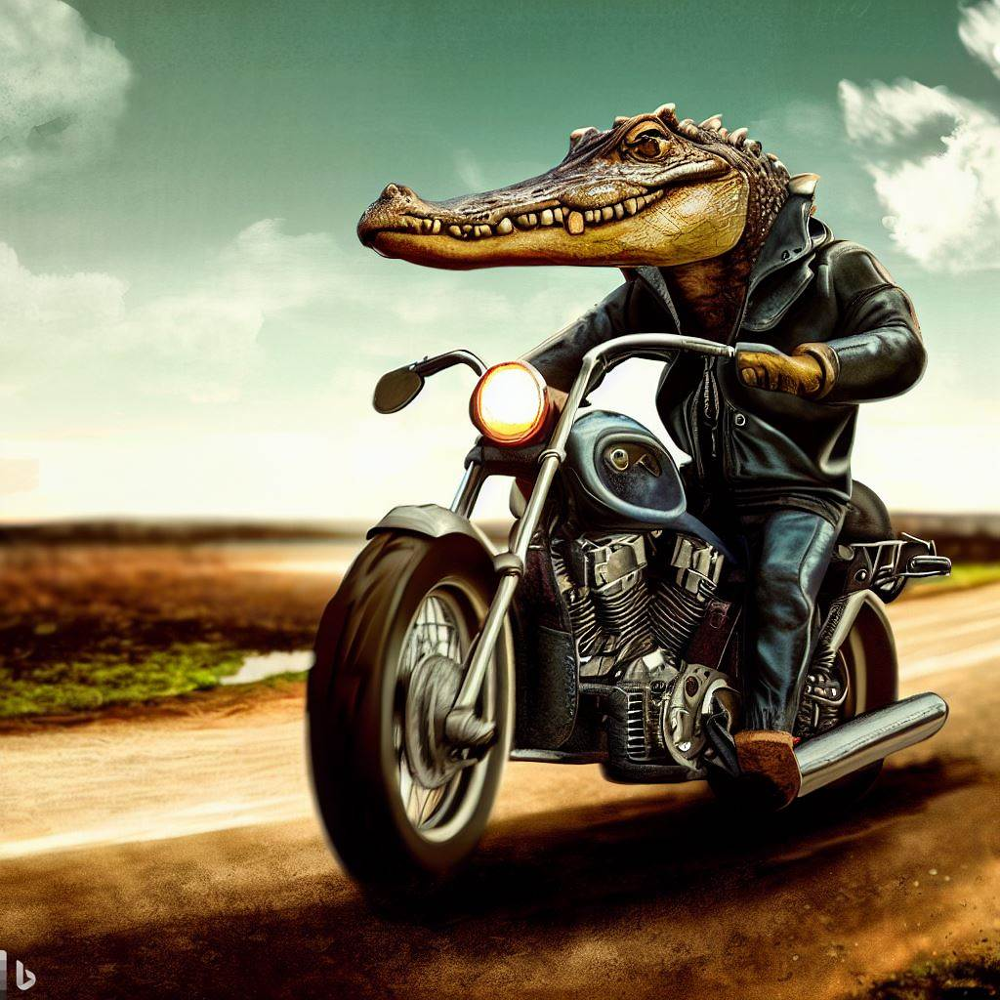

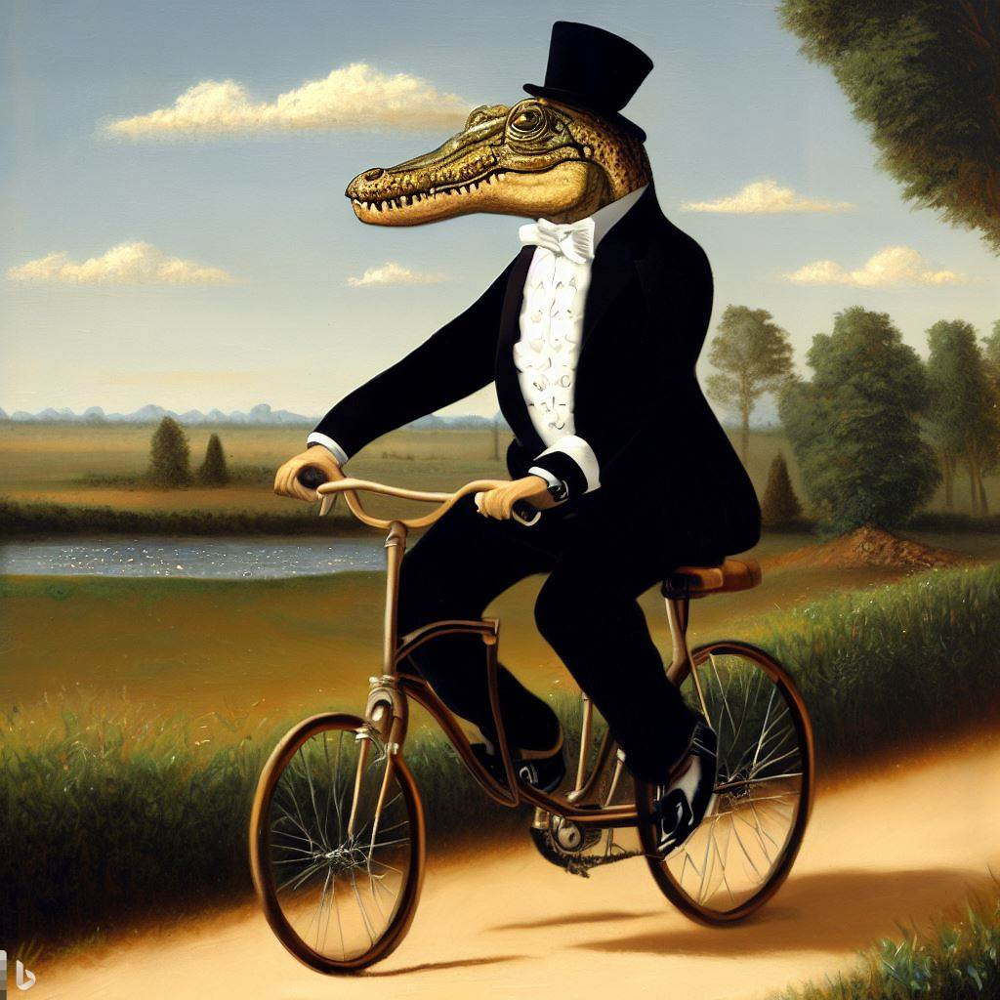

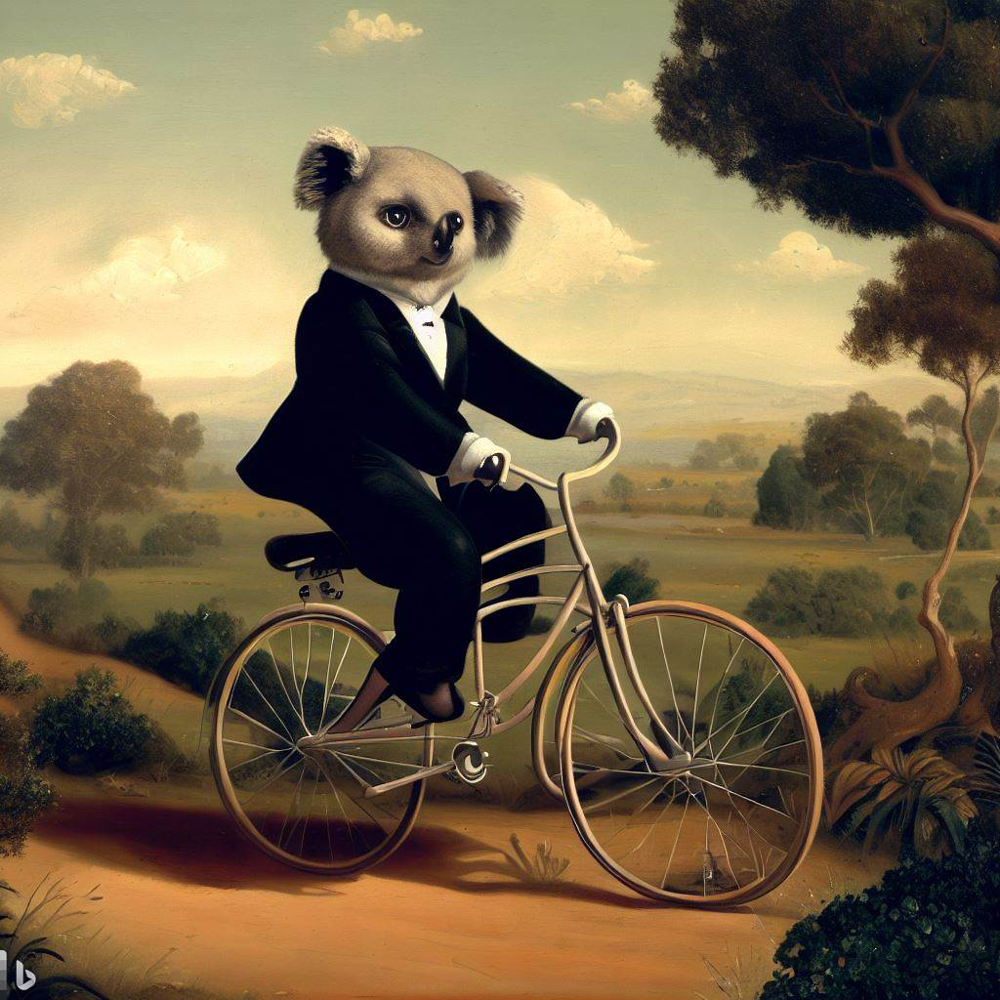

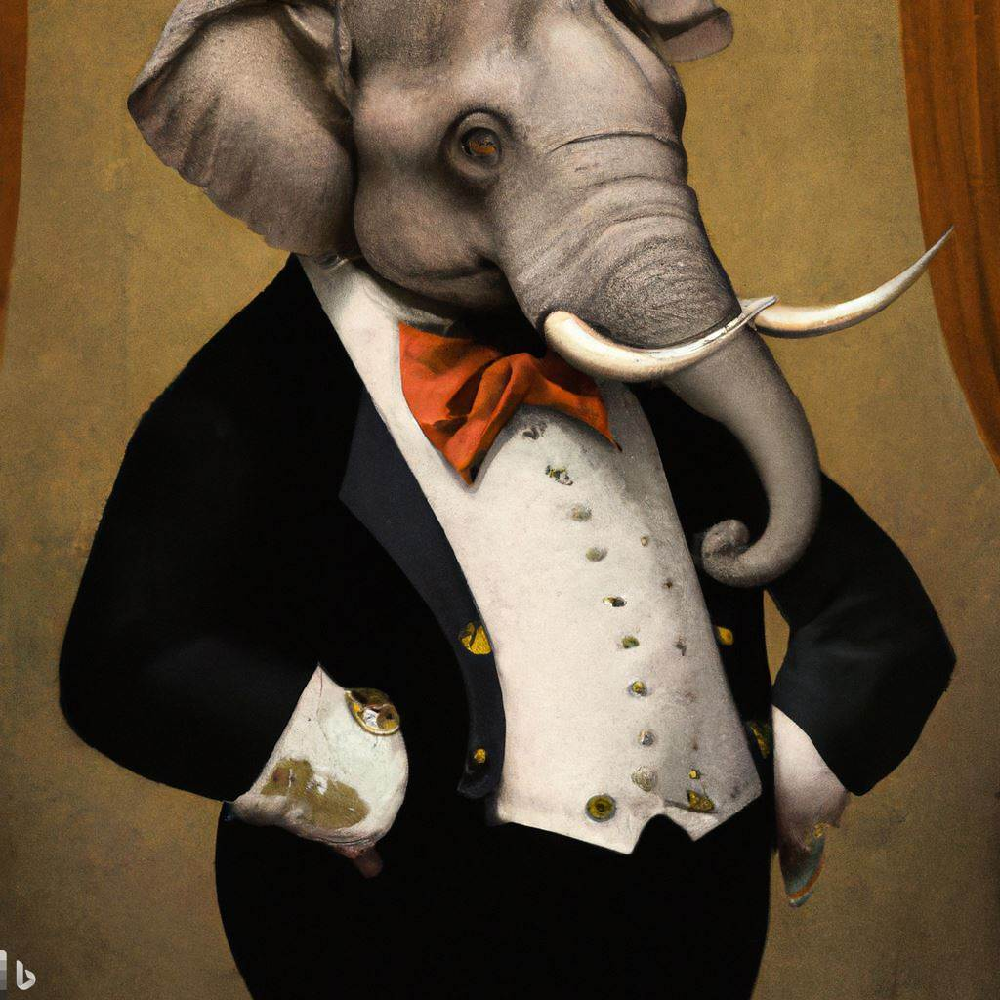

In [ ]:
# Load own image
images = ["monkey.jpg", "monkey2.jpeg", "wildphotoaward.jpeg", "wildphotoaward2.jpg", "giraffe_and_monkeys.jpeg", "crocodile_bike.jpeg", "crocodile_cycling.jpeg", "koala_cycling.jpeg", "elephant_tuxedo.jpeg"]
          
for image in images:
    input_image = Image.open(image)
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model

    # Print inital image but rotated
    display.display(Image.fromarray(np.array(input_image)))
    

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

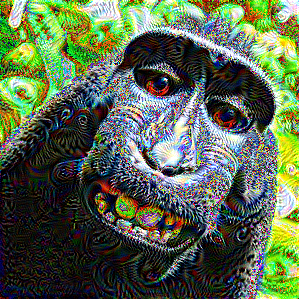

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

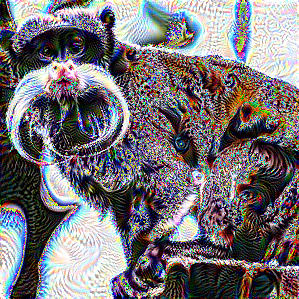

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

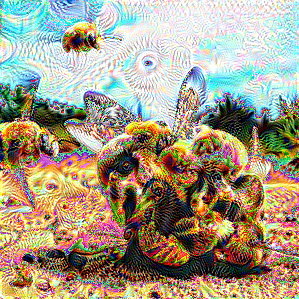

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

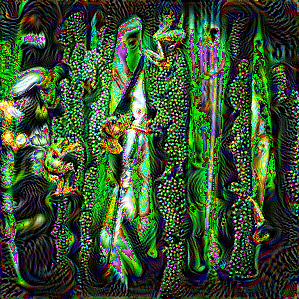

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

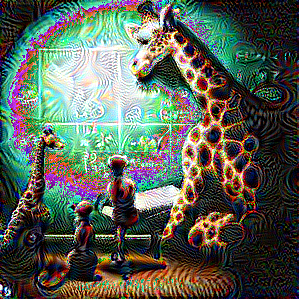

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

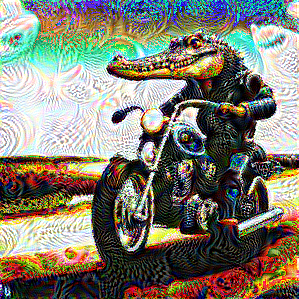

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

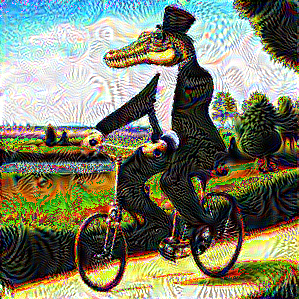

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

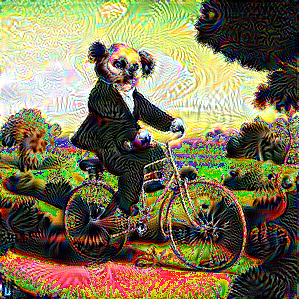

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/50 [00:00<?, ?it/s]

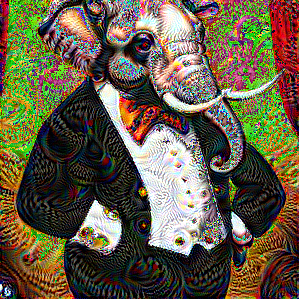

In [ ]:
layers = ['Mixed_6b', 'Mixed_6a', 'Mixed_5b']

for image in images:
    input_image = Image.open(image)
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0)
    model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
    model.to(device)
    model.eval()
    outputs = []
    for layer in layers:
        h = model._modules.get(layer).register_forward_hook(hook)
    dream_img = deepdream_layers(input_batch, iterations=50, lr=0.01)
    output_img = transforms.ToPILImage()(dream_img.squeeze(0))
    display.display(output_img)

/var/folders/rl/d4jq2g217cv1hy_ssxxj4k0r0000gn/T/ipykernel_86660/3787861105.py:2: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  output_img = output_img.resize((input_image.size[0]*2, input_image.size[1]*2), Image.ANTIALIAS)


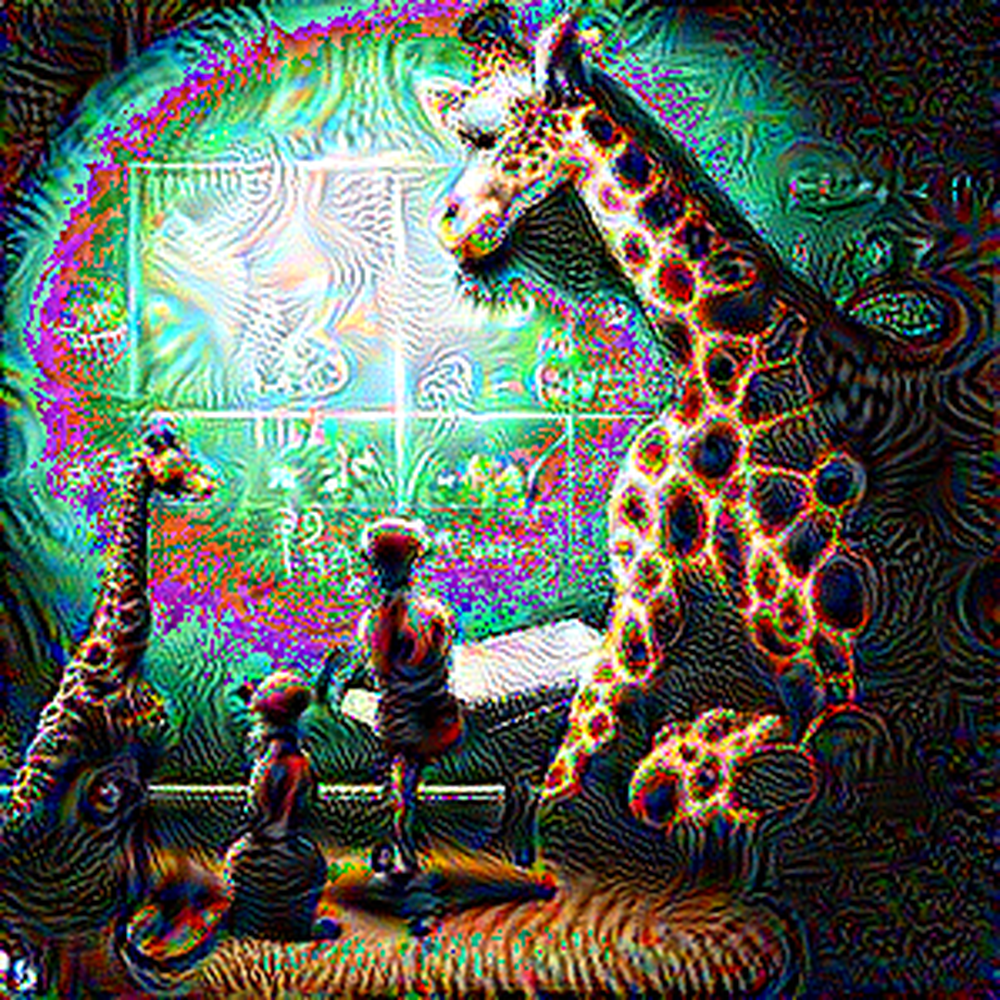

In [ ]:
# Augment resolution of output image
output_img = output_img.resize((input_image.size[0]*2, input_image.size[1]*2), Image.ANTIALIAS)
display.display(output_img)

